# GAN project
AIFFEL 대전 탐색 노드 12  
cifar10 이미지를 GAN을 이용하여 생성하는 프로젝트이다.

프로세스는 다음과 같다.     
1. Import package 
2. Data preprocessing
3. Modeling
4. Improvement
5. Analysis

## 1. Import package

In [1]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import Model
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.2.0


## 2. Data preprocessing
Data load   
normalization

In [2]:
# data load
cifar10 = tf.keras.datasets.cifar10
(train_x, train_y), (test_x, test_y) = cifar10.load_data()
train_x.shape

(50000, 32, 32, 3)

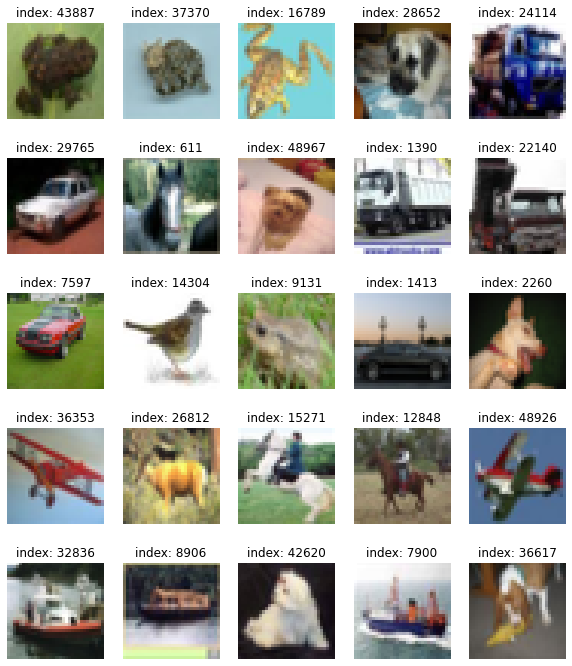

In [3]:
plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5, 5, i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow(train_x[random_index].reshape(32, 32, 3))
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()  

In [4]:
print("maxb pixel:", train_x.max())
print("min pixel:", train_x.min())

maxb pixel: 255
min pixel: 0


In [5]:
# normalization
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


In [6]:
# make dataset
BUFFER_SIZE = 50000
BATCH_SIZE = 64
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [7]:
label_dataset = tf.data.Dataset.from_tensor_slices((train_x,train_y)).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## 3. Modeling

DCGAN modeling

In [8]:
#DCGAN
def make_generator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2), use_bias=False, padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), use_bias=False, padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), use_bias=False, padding='same', \
                                     activation='tanh'))

    return model

In [9]:
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16384)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0

In [10]:
# check
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

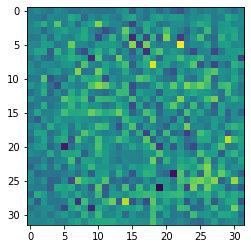

In [11]:
# test
plt.imshow(generated_image[0, :, :, 0])
plt.show()

In [12]:
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))    

    # Third: Conv2D Layer
    model.add(layers.Conv2D(32, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Fourth: Flatten Layer
    model.add(layers.Flatten())

    # Fifth: Dense Layer
    model.add(layers.Dense(1))
    

    return model

In [13]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 128)       9728      
_________________________________________________________________
batch_normalization_3 (Batch (None, 32, 32, 128)       512       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
dropout (Dropout)            (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 64)        204864    
_________________________________________________________________
batch_normalization_4 (Batch (None, 16, 16, 64)        256       
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 16, 16, 64)       

In [14]:
# check
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[0.00286283]], dtype=float32)>

In [15]:
# loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [16]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [17]:
# optimizer
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [18]:
# sampling
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

Training

In [19]:
# GAN training function
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [20]:
# sample images
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)  
    fig = plt.figure(figsize=(4, 4))
    
    predictions = predictions.numpy()
    predictions = (predictions * 127.5) + 127.5   # reverse of normalization
    predictions = predictions.astype(int)
        
    
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)    
        #plt.imshow(predictions[i, :, :, 0])
        plt.imshow(predictions[i])
        plt.axis('off')

    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [21]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

# history training curve
def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [22]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [23]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [24]:
save_every = 5
EPOCHS = 150

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

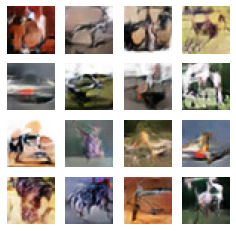

Time for training : 7103 sec


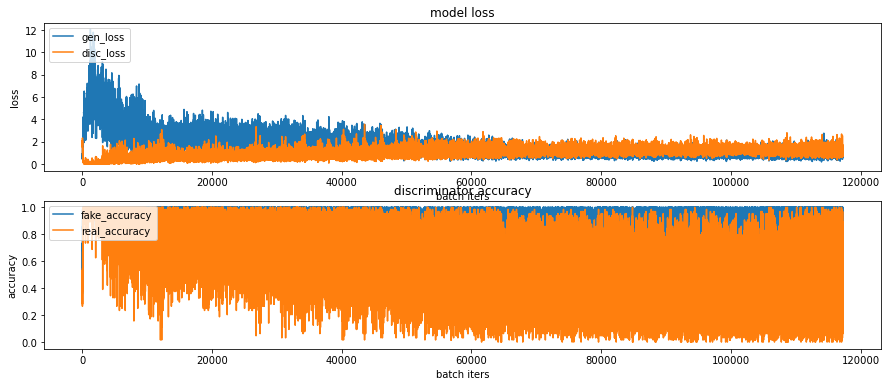

CPU times: user 45min 48s, sys: 2min 29s, total: 48min 18s
Wall time: 1h 58min 28s


In [25]:
%%time
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/cifar10/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

Result

In [26]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

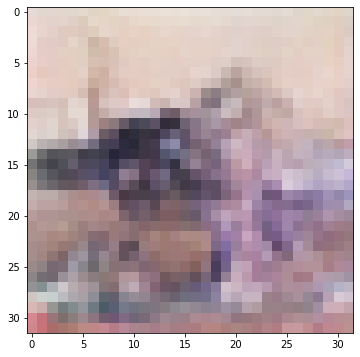

In [27]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

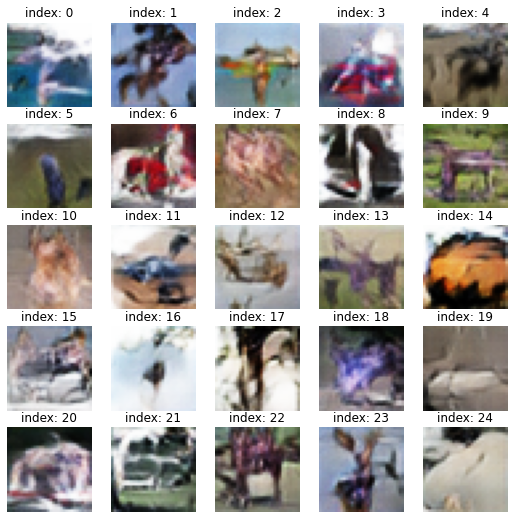

In [41]:
# result
noise = tf.random.normal([25, 100])
generated_image = generator(noise, training=False)
np_generated = generated_image.numpy()
np_generated = np_generated * 127.5 + 127.5  # reverse of normalization
np_generated = np_generated.astype(int)
plt.figure(figsize=(9, 9))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(np_generated[i])
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

## 4. Improvement
라벨링 정보를 추가하여 GAN을 학습하였다. 추가한 방법은 임베딩 후 라벨링 정보를 곱해주는 것이다.

In [72]:
# +label
def make_generator():
    
    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), use_bias=False, padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), use_bias=False, padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), use_bias=False, padding='same', \
                                     activation='tanh'))
    
    model.summary()
    noise = layers.Input(shape=(100,))
    label = layers.Input(shape=(1,), dtype='int32')
    label_embedding = layers.Flatten()(layers.Embedding(10, 100)(label))
    model_input = layers.multiply([noise, label_embedding])
    
    img = model(model_input)
    return Model([noise, label], img)
def make_discriminator():
    
    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Reshape((32,32,3), input_shape =(3072,)))
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(layers.Dropout(0.3))

    # Third: Conv2D Layer
    model.add(layers.Conv2D(32, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(layers.Dropout(0.3))
    
    # Fourth: Flatten Layer
    model.add(layers.Flatten())

    # Fifth: Dense Layer
    model.add(layers.Dense(1))
    
    img = layers.Input(shape=[32,32,3])
    label = layers.Input(shape=(1,), dtype='int32')

    label_embedding = layers.Flatten()(layers.Embedding(10,np.prod((32,32,3)))(label))
    flat_img = layers.Flatten()(img)
    
    model_input = layers.multiply([flat_img, label_embedding])
    validity = model(model_input)

    model.summary()
    return Model([img, label], validity)

In [73]:
l_generator = make_generator()
l_discriminator = make_discriminator()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 16384)             1638400   
_________________________________________________________________
batch_normalization_30 (Batc (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu_30 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_9 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_15 (Conv2DT (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_31 (Batc (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_31 (LeakyReLU)   (None, 8, 8, 128)       

In [74]:
# loss weighted
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = 0.7*real_loss + 0.3*fake_loss
    return total_loss

In [75]:
def generate_and_save_images_l(model, epoch, it, sample_seeds):

    predictions = model([sample_seeds,train_y[0]], training=False)  
    fig = plt.figure(figsize=(4, 4))
    
    predictions = predictions.numpy()
    predictions = (predictions * 127.5) + 127.5   # reverse of normalization
    predictions = predictions.astype(int)
    
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        #plt.imshow(predictions[i, :, :, 0])
        plt.imshow(predictions[i])
        plt.axis('off')

    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/l_generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [76]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history_l(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/l_training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [77]:
@tf.function
def train_step_l(images,labels):  #(1) 입력데이터
    #print(len(labels))
    noise = tf.random.normal([len(labels), noise_dim])  #(2) 생성자 입력 노이즈
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = l_generator([noise, labels], training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = l_discriminator([images,labels], training=True)
        fake_output = l_discriminator([generated_images,labels], training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, l_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, l_discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, l_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, l_discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [78]:
def train_l(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        it = 0
        for x,y in label_dataset:
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step_l(x,y)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images_l(l_generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))
            it = it+1
        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images_l(l_generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history_l(history, epoch)

In [79]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/l_training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=l_generator,
                                 discriminator=l_discriminator)

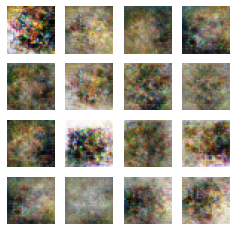

Time for training : 3552 sec


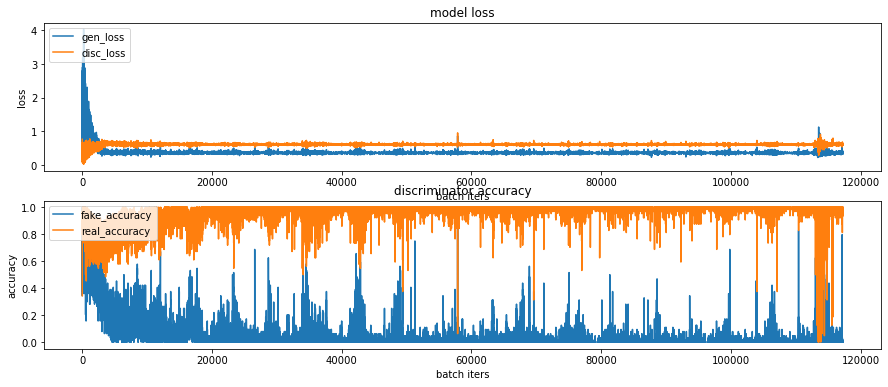

CPU times: user 48min 50s, sys: 3min 8s, total: 51min 59s
Wall time: 59min 16s


In [80]:
%%time
train_l(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/cifar10/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

In [60]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_l.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/l_generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

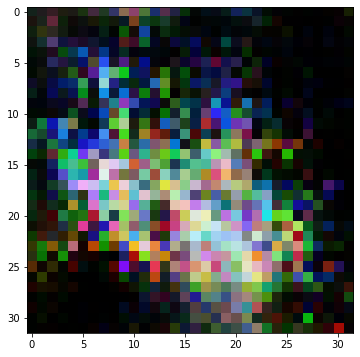

In [61]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/l_training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

l_generator = checkpoint.generator
l_discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = l_generator([noise, train_y[0]], training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

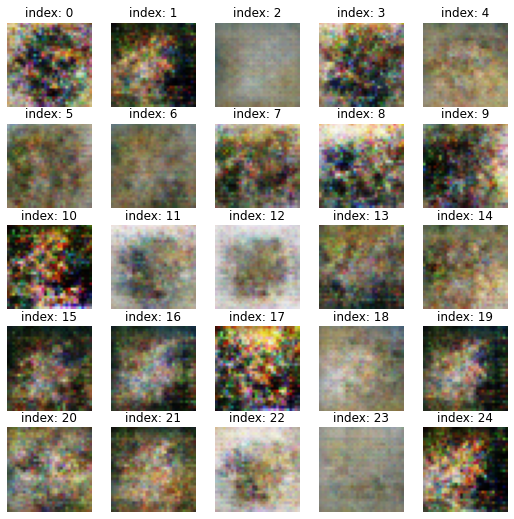

In [84]:
# result
noise = tf.random.normal([25, 100])
generated_image = l_generator([noise,train_y[0]], training=False)
np_generated = generated_image.numpy()
np_generated = np_generated * 127.5 + 127.5  # reverse of normalization
np_generated = np_generated.astype(int)
plt.figure(figsize=(9, 9))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(np_generated[i])
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

labeling을 사용하지 않은 경우

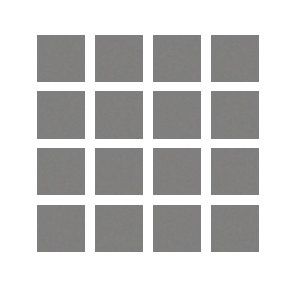

labeling을 사용한 경우

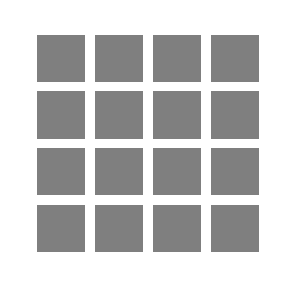

처음 시도들   
라벨링을 추가한 모델은 좀 처럼 좋은 이미지에 수렴하지 않는다.   
2000 epoch으로 시도해 보았을 때 epoch이 클수록 좋은 건 아닌 것을 보여준다.

처음 GAN 모델의 학습 과정
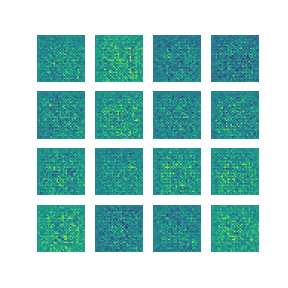

라벨링을 추가한 GAN 모델의 학습 과정
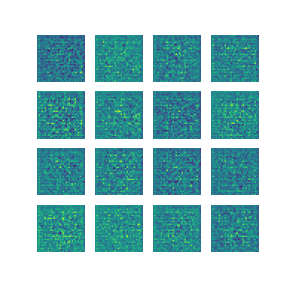

처음 GAN 모델에 2000 epoch일 때 모습
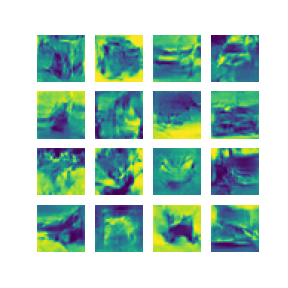

## 5.Analysis
기본적인 DCGAN과 라벨링 정보를 추가한 DCGAN에 대해서 학습을 진행하였다.   
loss를 살펴보면 처음 모델의 경우 generator와 discriminator과 비슷하게 수렴을 하는 것을 알 수 있다. 그리고 정확도 측면에서도 fake, real 모두 진동폭이 커지면서 평균적으로 낮아지는 것을 알 수 있다.   
라벨링 정보를 추가한 것을 살펴보면 loss와 정확도 2가지 모두 구분되는 특징을 보인다. loss의 경우, generator loss가 discriminator보다 높았고, 정확도의 경우, real는 잘 구별하지만 fake은 잘 구분 못하는 것을 보여준다.   
학습 곡선의 결과로도 알 수 있듯이 라벨링을 추가하지 않은 모델이 더 그럴듯한 이미지를 생성한 것을 볼 수 있다. 라벨링을 추가한 경우에는 아마도 추가한 정보의 도움으로 모델의 loss가 빠르게 수렴하여 noise 이미지가 생성된 것 같다.
코드로 나타내지 않은 여러 가지 시도들이 있었지만 라벨링을 추가한 경우에는 적절한 이미지를 생성하는 방법을 찾아내지는 못하였다.

## 회고 및 루브릭 평가

### 루브릭 평가 항목
1. GAN의 두 모델 구조를 통해 이미지를 성공적으로 생성하였다.(오브젝트 종류를 육안으로 구별할 수 있을 만한 이미지를 생성하였다.)
2. 생성 이미지 시각화 및 학습 그래프를 통해 GAN 학습이 바르게 진행되었음을 입증하였다.(gif를 통해 생성이미지 품질이 서서히 향상되는 것과, fake accuracy가 추세적으로 0.5를 향해 하향하고 있음을 확인하였다.)
3. 추가적인 GAN 모델구조 혹은 학습과정 개선 아이디어를 제안하고 이를 적용하였다.(제출 아이디어를 제출 프로젝트에 반영하고, 그 결과가 아이디어 적용 이전보다 향상되었음을 시각적으로 입증하였다.)

### 평가 항목에 대한 수행
1. DCGAN 모델을 이용하여 생성한 이미지가 어느 정도 그럴 듯하다. (사슴이나 말 등의 동물들이 보이는 것 같다.)
2. 생성 이미지 시각화 및 학습 그래프를 보았을 때, loss가 약간의 진동 폭을 가지며 수렴을 하고 acc가 큰 진동폭을 보이지만 평균적으로 0.5인 것을 알 수 있다. 그리고 마지막에 gif를 보면 점차 어떤 형상들을 만들어 가는 것을 볼 수 있다.
3. GAN의 개선 아이디어 중 라벨링 정보를 추가한 방법을 적용해보았다.

### 회고

노션에 공지된 꼭 포함이 되어야 할 점
- 이번 프로젝트에서 **어려웠던 점,**
- 프로젝트를 진행하면서 **알아낸 점** 혹은 **아직 모호한 점**.
- 루브릭 평가 지표를 맞추기 위해 **시도한 것들**.
- 만약에 루브릭 평가 관련 지표를 **달성 하지 못했을 때, 이유에 관한 추정**.
- **자기 다짐**

---
- **어려웠던 점**    
아무리 모델 구조를 바꾸거나 loss를 수정하고 라벨링 정보를 추가하여도 원하는 모양의 이미지를 생성하는 것이 어려웠다. 정확히 어떤 구조가 어떤 영향을 미치는 지에 대해서 알기 어려워서 하이퍼 파라미터를 찾는 것도 대략적인 감에 의존을 할 수 밖에 없었다. 그리고 학습을 하는데 계속 커널이 죽어서 학습을 제대로 하기가 매우 힘들었다. 커널이 죽는 것 때문에 한 10번은 더 학습 시킨 것 같다.
---
- **알아낸 점**    
GAN이 만능이 아니라는 것을 확인할 수 있었다. 많은 구조에 대해서 실험을 해 봤는데 구조가 변한다고 크게 변하지는 않았다. 적어도 cifar10 데이터셋에 대해서는 그럴듯한 데이터를 생성해내는 데에 DCGAN 모델로는 힘들다는 것을 알 수 있었다. GAN을 보면 여러 가지 방면에 대해서 발전한 것들이 있는데 좀 더 개선된 GAN들을 이용해야 할 것 같다고 느꼈다.

- **모호한 점**    
라벨링 정보를 추가하면 오히려 좋은 이미지를 생성하는 데 안 좋은 영향을 주는 것을 관찰 했다. 이 점에 대해서도 왜 그런 지는 명확히 알기 어려웠다.
---
- **시도한 것들**   
모델을 열심히 바꿔서 실험을 해보았다. convolution layer 개수, channel 수, kernel size, batch normalization, dropout, labeling, weighted loss 등 여러 가지를 바꿔서 실험을 해 봤으나 거의 비슷한 결과를 보여준다는 것을 알 수 있었다.

---
- **우브릭 평가 관련 지표**   
제 예상에는 모두 달성되었다고 생각한다. 그 이유는 위에 있는 **평가 항목에 대한 수행**에 나와있다.  
- **자기 다짐** 및 **나의 생각들**      
이번에 GAN에 대해서 공부할 수 있는 시간을 가질 수 있었다. 공부를 하다보니 처음에 나온 GAN이 이미지를 잘 생성할 수 있었던 것은 기적에 가까운 일이였다는 것을 보았다. 실제로 직접해보니 왜인지를 느낄 수 있었다. 그래서 나중에 GAN을 개선한 모델 구조들을 보면 여러 측면에 대해서 개선한 것들을 볼 수가 있다. 원하는 이미지를 잘 생성하려면 더 깊은 공부를 해야 한다고 생각한다. 아직도 모르는 것 투성이라 공부를 더 많이 해야 할 것 같다. 그리고 신경망에 대해서 좀 더 설명 가능한 방법에 대해서 찾아야 겠다는 생각이 들었다.